In [ ]:
############EXAMEN FINAL###############
# LISTA DE PAQUETES NECESARIOS CON SU DESCRIPCIÓN

#numpy - Manipulación de arrays numéricos y operaciones matemáticas
# pip install numpy  
# # Sirve para cálculos matriciales y operaciones numéricas eficientes

#biopython - Análisis de datos biológicos (estructuras PDB en este caso)
#pip install biopython  # Proporciona herramientas para trabajar con estructuras de proteínas (PDBParser)

#py3Dmol - Visualización 3D interactiva de moléculas
#pip install py3Dmol  # Permite visualizar estructuras moleculares en el navegador o Jupyter Notebooks

# IPython - Funcionalidades extendidas para entornos interactivos
# #pip install ipython  # Proporciona display, Markdown y HTML para mostrar contenido enriquecido

#pandas - Análisis y manipulación de datos tabulares
#pip install pandas  # Para manejar DataFrames (estructuras de datos tabulares)

#rdkit - Suite completa para quimioinformática
#pip install rdkit  # O mejor con conda:
#conda install -c conda-forge rdkit  # Proporciona:
#• Chem: Manipulación molecular básica
#  • Descriptors/Crippen/Lipinski: Cálculo de descriptores
#• AllChem: Operaciones avanzadas
#• rdMolDescriptors: Descriptores moleculares
#• rdMolDraw2D: Visualización 2D

#matplotlib - Visualización gráfica
# pip install matplotlib  # Para crear gráficos (plt)

#seaborn - Visualización estadística avanzada
#pip install seaborn  # Gráficos más atractivos (sns)



# PAQUETES INCLUIDOS EN PYTHON (no requieren instalación):
#• os (sistema operativo)
#• io (entrada/salida)
#• warnings (manejo de alertas)


In [ ]:
########GUIA####################
# 1.-(OPCIONAL)Si ya se tiene {imipenem.pdb}, no es necesario realizar la converción de Imipenem.sdf a imipenem.pdb
# 2.-(Opcional),si se desea ver la estructura del imipenem y del ndm-1 que se usará. CORRER :VISUALIZACION EN 3D DE IMIPENEM 
# y VISUALIZACIÓN EN 3D DE NDM-1
#3.- CORRER : " 1. SIMULACIÓN DEL MECANISMO DE ACCION DEL IMIPENEM FRENTE A NDM-1", en este se verá la simulación por pasos
##del mecanismo imipenem con ndm-1
#4.- CORRER : "2. PROPUESTAS DE MODIFICACIÓN DEL IMIPENEM", en este se generaran nuevos .pdb con las modificaciones y se verán en 3d
#5.- CORRER: "3. EVALUACION COMPUTACIONAL", en este se analizarán las propuestas
#FINALMENTE se tiene el informe técnico en word
#ADEMÁS existen 2 programas.html
#Y 2 .txt y uno .csv

In [ ]:
######CONVERTI .SDF A .PDB (opcional)#########
from rdkit import Chem

mol = Chem.MolFromMolFile("Imipenem.sdf")
Chem.MolToPDBFile(mol, "imipenem.pdb")

In [ ]:
###################VISUALIZACION EN 3D DE IMIPENEM############
import py3Dmol

# Cargar el PDB del antibiótico (ej: Imipenem)
with open("imipenem.pdb") as f:
    mol_data = f.read()

view = py3Dmol.view(width=800, height=600)
view.addModel(mol_data, "pdb")

# Estilo para pequeñas moléculas
view.setStyle({'stick': {'colorscheme': 'greenCarbon'}})  # Estilo "stick" con carbonos verdes

# Añadir etiquetas de átomos
view.addPropertyLabels("index", {"fontColor": "black", "fontSize": 12})

view.zoomTo()
view.show()

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [ ]:
######VISUALIZACIÓN EN 3D DE NDM-1#############################
import py3Dmol

# Cargar el archivo PDB
#view = py3Dmol.view(query='pdb:4EY2')  # Usando un código PDB directamente (ej: 4EY2 para NDM-1)
# O desde un archivo local:
with open("ndm1_fixed.pdb") as f:
    pdb_data = f.read()
view = py3Dmol.view(width=800, height=600)
view.addModel(pdb_data, "pdb")

# Estilo de visualización
view.setStyle({'cartoon': {'color': 'spectrum'}})  # Estilo cartoon para proteínas
#view.addSurface(py3Dmol.VDW, {'opacity': 0.7, 'color': 'white'})  # Superficie transparente

# Rotación y zoom
view.zoomTo()

# Mostrar en Jupyter Notebook
view.show()

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [7]:
##########1. SIMULACIÓN DEL MECANISMO DE ACCION DEL IMIPENEM FRENTE A NDM-1##########################


import numpy as np
from Bio.PDB import PDBParser
import py3Dmol
import warnings
warnings.filterwarnings('ignore')

class NDM1RealStructureSimulation:
    def __init__(self, ndm1_file="ndm1_fixed.pdb", imipenem_file="imipenem.pdb"):
        self.ndm1_file = ndm1_file
        self.imipenem_file = imipenem_file
        
        # Parsear estructuras reales
        self.parser = PDBParser(QUIET=True)
        self.ndm1_structure = None
        self.imipenem_structure = None
        
        # Estados de simulación
        self.stage = 0
        self.frame_count = 0
        self.max_stages = 5
        
        # Cargar estructuras
        self.load_structures()
        
        # Posiciones para animación (coordenadas relativas)
        self.imipenem_offset = [15.0, 0.0, 0.0]  # Desplazamiento inicial
        self.original_imipenem_coords = None
        self.beta_lactam_broken = False
        
        self.water_position = None
        self.water_attack_progress = 0
        self.hydrolysis_complete = False

        print("🧬 Estructuras cargadas:")
        print(f"✅ NDM-1: {ndm1_file}")
        print(f"✅ Imipenem: {imipenem_file}")
    
    def load_structures(self):
        """Carga las estructuras PDB reales"""
        try:
            self.ndm1_structure = self.parser.get_structure("NDM1", self.ndm1_file)
            self.imipenem_structure = self.parser.get_structure("Imipenem", self.imipenem_file)
            
            # Obtener átomos de zinc de NDM-1
            self.zinc_atoms = []
            for model in self.ndm1_structure:
                for chain in model:
                    for residue in chain:
                        if residue.get_resname() == "ZN":
                            for atom in residue:
                                if atom.get_name() == "ZN":
                                    self.zinc_atoms.append(atom.get_coord())
            
            # Obtener centro de masa del imipenem
            self.imipenem_center = self.get_center_of_mass(self.imipenem_structure)
            self.original_imipenem_coords = self.get_all_coords(self.imipenem_structure)
            # Identificar manualmente átomos clave si es necesario
            self.beta_lactam_atoms = []
            for residue in self.imipenem_structure.get_residues():
                for atom in residue:
                    if atom.get_name() in ['C7', 'C8', 'N1']:
                        self.beta_lactam_atoms.append(atom.get_coord())
    
            print(f"🔬 Átomos del anillo β-lactámico identificados: {len(self.beta_lactam_atoms)}")
            print(f"🎯 Zinc encontrado: {len(self.zinc_atoms)} átomos")
            print(f"🎯 Centro de Imipenem: {self.imipenem_center}")
            
        except Exception as e:
            print(f"❌ Error cargando estructuras: {e}")
            print("Usando simulación simplificada...")
            self.use_simplified = True
    
    def get_center_of_mass(self, structure):
        """Calcula el centro de masa de una estructura"""
        coords = []
        for model in structure:
            for chain in model:
                for residue in chain:
                    for atom in residue:
                        coords.append(atom.get_coord())
        return np.mean(coords, axis=0) if coords else np.array([0, 0, 0])
    
    def get_all_coords(self, structure):
        """Obtiene todas las coordenadas de una estructura"""
        coords = []
        for model in structure:
            for chain in model:
                for residue in chain:
                    for atom in residue:
                        coords.append(atom.get_coord())
        return np.array(coords)
    
    def create_3d_visualization(self):
        """Crea visualización 3D con py3Dmol usando estructuras reales"""
        view = py3Dmol.view(width=800, height=600)
        
        # Cargar NDM-1
        with open(self.ndm1_file, 'r') as f:
            ndm1_pdb = f.read()
        view.addModel(ndm1_pdb, "pdb")
        
        # Cargar Imipenem con desplazamiento según la etapa
        with open(self.imipenem_file, 'r') as f:
            imipenem_pdb = f.read()
        
        # Modificar coordenadas del imipenem según la etapa
        modified_imipenem_pdb = self.modify_imipenem_position(imipenem_pdb)
        view.addModel(modified_imipenem_pdb, "pdb")
        
        # Estilos
        view.setStyle({"model": 0}, {"cartoon": {"color": "spectrum"}})
        view.setStyle({"model": 1}, {"stick": {"colorscheme": "redCarbon"}})
        
        # Resaltar zinc
        view.addStyle({"resn": "ZN"}, {"sphere": {"radius": 1.2, "color": "orange"}})
        
        # Resaltar residuos catalíticos importantes
        if self.stage >= 2:
            view.addStyle({"resi": "120"}, {"stick": {"color": "magenta"}})  # Residuo K120
            view.addStyle({"resi": "122"}, {"stick": {"color": "yellow"}})   # Residuo D122
        
        # Efectos según la etapa
        if self.stage >= 2:
            # Superficie del sitio activo
            view.addSurface(py3Dmol.VDW, {"opacity": 0.3, "color": "blue"}, 
                          {"model": 0, "resi": "55,56,58,116,118,196"})  # Residuos del sitio activo típicos
        
        # Representación del agua catalítica
        if self.stage >= 2 and self.zinc_atoms:
            zn_pos = self.zinc_atoms[0]
            imi_pos = self.imipenem_center
            
            # Posición inicial del agua (cerca del zinc)
            if self.water_position is None:
                self.water_position = zn_pos + np.array([1.5, 1.0, 0.0])
            
            # Animar ataque nucleofílico en la etapa 3
            if self.stage == 3:
                # Calcular posición intermedia
                progress = min(self.water_attack_progress / 100, 1.0)
                attack_vector = imi_pos - self.water_position
                water_pos = self.water_position + attack_vector * progress
                
                # Identificar carbono carbonílico para mostrar la flecha
                carbonyl_c_pos = None
                for atom_line in modified_imipenem_pdb.split('\n'):
                    if 'C8' in atom_line and ('ATOM' in atom_line or 'HETATM' in atom_line):
                        parts = atom_line.split()
                        carbonyl_c_pos = np.array([float(parts[5]), float(parts[6]), float(parts[7])])
                        break
                
                # Dibujar agua y flecha de ataque
                view.addSphere({
                    "center": {"x": water_pos[0], "y": water_pos[1], "z": water_pos[2]},
                    "radius": 1.0,
                    "color": "blue",
                    "opacity": 0.7
                })
                
                # Mostrar flecha de ataque si tenemos la posición del carbono
                if carbonyl_c_pos is not None:
                    view.addArrow({
                        "start": {"x": water_pos[0], "y": water_pos[1], "z": water_pos[2]},
                        "end": {"x": carbonyl_c_pos[0], "y": carbonyl_c_pos[1], "z": carbonyl_c_pos[2]},
                        "color": "red",
                        "radius": 0.2
                    })
                
                # Avanzar la animación del ataque
                if not self.hydrolysis_complete:
                    self.water_attack_progress += 5
                    if self.water_attack_progress >= 100:
                        self.beta_lactam_broken = True
                        self.hydrolysis_complete = True
        
        if self.stage == 3 and self.beta_lactam_broken:
            # Cambiar color del imipenem cuando se rompe
            view.setStyle({"model": 1}, {"stick": {"colorscheme": "greenCarbon"}})
        
        # Centrar en el complejo
        if self.stage >= 1:
            view.zoomTo({"model": 0, "resn": "ZN"})
        else:
            view.zoomTo()
        
        return view
    
    def modify_imipenem_position(self, pdb_content):
        """Modifica la posición del imipenem preservando su estructura"""
        lines = pdb_content.split('\n')
        modified_lines = []
        
        # Obtener centro actual de Imipenem
        current_center = self.imipenem_center
        
        for line in lines:
            if line.startswith('ATOM') or line.startswith('HETATM'):
                # Extraer coordenadas
                x = float(line[30:38])
                y = float(line[38:46]) 
                z = float(line[46:54])
                original_coord = np.array([x, y, z])
                
                # Calcular desplazamiento desde el centro
                offset_from_center = original_coord - current_center
                
                # Aplicar transformación según la etapa
                if self.stage == 0:  # Lejos
                    target_center = current_center + np.array(self.imipenem_offset)
                elif self.stage == 1:  # Acercándose
                    target_center = current_center + np.array(self.imipenem_offset) * 0.5
                elif self.stage >= 2:  # En el sitio activo
                    if self.zinc_atoms:
                        # Posición objetivo cerca del zinc (manteniendo estructura)
                        target_center = np.mean(self.zinc_atoms, axis=0) + np.array([3.0, 0.0, 0.0])
                
                # Nueva posición preservando geometría molecular
                new_coord = target_center + offset_from_center
                x, y, z = new_coord
                
                # Si el anillo está roto, modificar solo átomos específicos
                if self.beta_lactam_broken and self.is_beta_lactam_atom(line):
                    # Romper el enlace C-N del anillo
                    if 'C8' in line:  # Átomo de carbono del anillo β-lactámico
                        x += 1.2  # Separar físicamente los fragmentos
                        y += 0.8
                    elif 'N1' in line:  # Átomo de nitrógeno
                        x -= 1.0
                        y -= 0.5
                
                # Reconstruir línea
                new_line = line[:30] + f"{x:8.3f}{y:8.3f}{z:8.3f}" + line[54:]
                modified_lines.append(new_line)
            else:
                modified_lines.append(line)
        
        return '\n'.join(modified_lines)
    
    def is_beta_lactam_atom(self, line):
        """Identifica átomos del anillo β-lactámico"""
        # Estos nombres de átomos dependen de la estructura PDB específica
        beta_lactam_atoms = ['C7', 'C8', 'N1', 'C9'] 
        return any(atom in line for atom in beta_lactam_atoms)

    def run_3d_simulation(self):
        """Ejecuta simulación 3D paso a paso"""
        stage_descriptions = [
            "🎯 Etapa 1: Imipenem libre en solución",
            "🤝 Etapa 2: Aproximación al sitio activo de NDM-1", 
            "⚡ Etapa 3: Formación del complejo enzima-sustrato",
            "💥 Etapa 4: Hidrólisis del anillo β-lactámico",
            "✅ Etapa 5: Producto inactivo formado"
        ]
        
        print("\n🧬 SIMULACIÓN 3D: NDM-1 vs IMIPENEM")
        print("=" * 50)
        
        for stage in range(5):
            self.stage = stage
            print(f"\n{stage_descriptions[stage]}")
            
            if stage == 3:
                self.beta_lactam_broken = True
                print("💥 ¡Anillo β-lactámico hidrolizado!")
            
            print("Generando visualización 3D...")
            view = self.create_3d_visualization()
            
            # Agregar título y descripción
            view.addLabel(stage_descriptions[stage], 
                         {"position": {"x": 0, "y": 0, "z": 0}, 
                          "backgroundColor": "black", "fontColor": "white"})
            
            view.show()
            
            if stage < 4:
                input("Presiona Enter para continuar a la siguiente etapa...")
        
        print("\n🎉 ¡Simulación completada!")
        print("📊 Resultado: Imipenem inactivado → Resistencia bacteriana")
    
    def run_simulation(self):
        """Ejecuta simulación solo con visualización 3D"""
        print("\n🧬 SIMULACIÓN: Estructuras Reales 3D")
        print("=" * 50)
        
        print("🎬 Iniciando visualización 3D paso a paso...")
        self.run_3d_simulation()

# Función principal
def main():
    print("🧬 SIMULACIÓN NDM-1 vs IMIPENEM - ESTRUCTURAS REALES")
    print("=" * 55)
    
    # Verificar archivos
    import os
    ndm1_file = "ndm1_fixed.pdb"
    imipenem_file = "imipenem.pdb"
    
    if not os.path.exists(ndm1_file):
        print(f"❌ No se encuentra {ndm1_file}")
        return
    if not os.path.exists(imipenem_file):
        print(f"❌ No se encuentra {imipenem_file}")
        return
    
    print(f"✅ Archivos encontrados:")
    print(f"   📁 {ndm1_file}")
    print(f"   📁 {imipenem_file}")
    
    # Crear simulación
    sim = NDM1RealStructureSimulation(ndm1_file, imipenem_file)
    sim.run_simulation()

if __name__ == "__main__":
    main()

    

🧬 SIMULACIÓN NDM-1 vs IMIPENEM - ESTRUCTURAS REALES
✅ Archivos encontrados:
   📁 ndm1_fixed.pdb
   📁 imipenem.pdb
🔬 Átomos del anillo β-lactámico identificados: 3
🎯 Zinc encontrado: 10 átomos
🎯 Centro de Imipenem: [ 0.0000000e+00 -4.9999355e-05 -9.9998710e-05]
🧬 Estructuras cargadas:
✅ NDM-1: ndm1_fixed.pdb
✅ Imipenem: imipenem.pdb

🧬 SIMULACIÓN: Estructuras Reales 3D
🎬 Iniciando visualización 3D paso a paso...

🧬 SIMULACIÓN 3D: NDM-1 vs IMIPENEM

🎯 Etapa 1: Imipenem libre en solución
Generando visualización 3D...


3Dmol.js failed to load for some reason. Please check your browser console for error messages.


🤝 Etapa 2: Aproximación al sitio activo de NDM-1
Generando visualización 3D...


3Dmol.js failed to load for some reason. Please check your browser console for error messages.


⚡ Etapa 3: Formación del complejo enzima-sustrato
Generando visualización 3D...


3Dmol.js failed to load for some reason. Please check your browser console for error messages.


💥 Etapa 4: Hidrólisis del anillo β-lactámico
💥 ¡Anillo β-lactámico hidrolizado!
Generando visualización 3D...


3Dmol.js failed to load for some reason. Please check your browser console for error messages.


✅ Etapa 5: Producto inactivo formado
Generando visualización 3D...


3Dmol.js failed to load for some reason. Please check your browser console for error messages.


🎉 ¡Simulación completada!
📊 Resultado: Imipenem inactivado → Resistencia bacteriana


Cargando estructura base del imipenem...
✅ Estructura base cargada desde imipenem.pdb
   Átomos: 20
   Fórmula: C12H17N3O4S

Verificación de SMILES para derivados:
SMILES para derivados válido: True
Fórmula molecular: C12H17N3O4S
✓ Base_Imipenem: Cargado desde imipenem.pdb

Validando derivados del imipenem:
✓ Imipenem_Metoxi: C13H19N3O5S
✓ Imipenem_Tioester: C12H17N3O3S2
✓ Imipenem_Acetil: C14H19N3O5S
✓ Imipenem_Combinado: C15H21N3O5S2

Generando estructuras 3D...
✓ Generado desde PDB original: imipenem_Base_Imipenem.pdb
✓ Generado: imipenem_Imipenem_Metoxi.pdb
✓ Generado: imipenem_Imipenem_Tioester.pdb
✓ Generado: imipenem_Imipenem_Acetil.pdb
✓ Generado: imipenem_Imipenem_Combinado.pdb

VISUALIZADOR 3D GENERADO


### 🧬 Visualizador Interactivo de Derivados de Imipenem (CORREGIDO)


Generando estructuras 2D...


### 📊 Representación 2D de las Moléculas

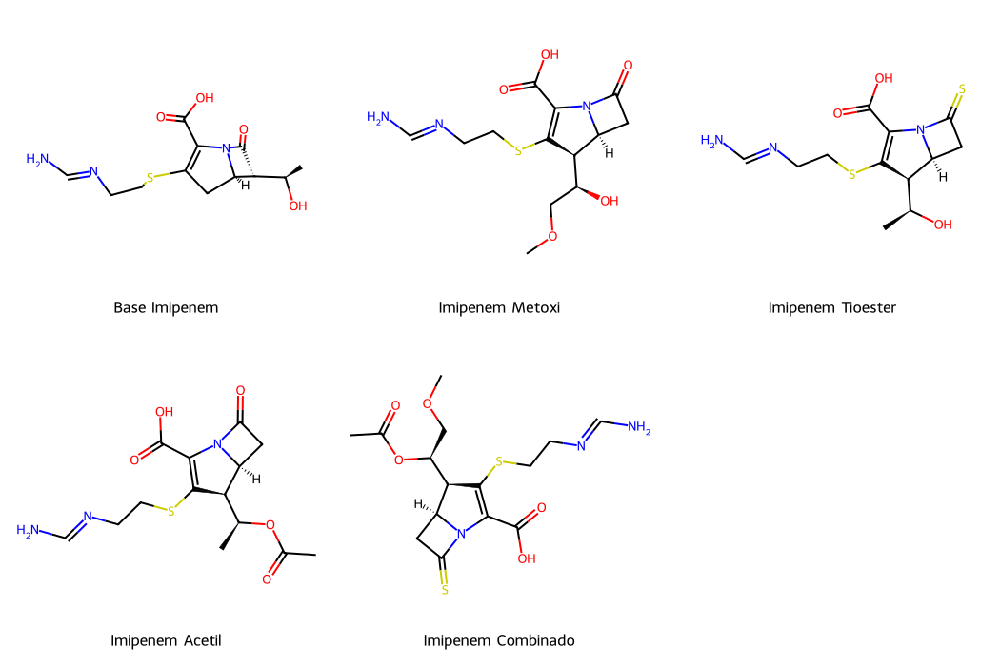

### 📁 Descargar Estructuras 3D (PDB)

- [Base Imipenem](imipenem_Base_Imipenem.pdb)

- [Imipenem Metoxi](imipenem_Imipenem_Metoxi.pdb)

- [Imipenem Tioester](imipenem_Imipenem_Tioester.pdb)

- [Imipenem Acetil](imipenem_Imipenem_Acetil.pdb)

- [Imipenem Combinado](imipenem_Imipenem_Combinado.pdb)


### ℹ️ Información Adicional


**Estructura del imipenem:**
- Es un antibiótico carbapenem β-lactámico
- Contiene un anillo β-lactámico fusionado con un anillo de 5 miembros
- Cadena lateral con grupo hidroxietilo en posición 6
- Sustituyente tioéter en posición 3

**Modificaciones propuestas:**
- **Metoxi**: Adición de grupo metoxi en la cadena lateral
- **Tioéster**: Reemplazo del carbonilo β-lactámico por tiocarbonilo
- **Acetil**: Acetilación del grupo hidroxilo
- **Combinado**: Combinación de las modificaciones anteriores


In [8]:
######2. PROPUESTAS DE MODIFICACIÓN DEL IMIPENEM#######

from rdkit import Chem
from rdkit.Chem import AllChem, Draw
import py3Dmol
import os
from IPython.display import display, Markdown, HTML
import numpy as np

# Cargar la estructura base desde tu archivo PDB
def load_imipenem_from_pdb(pdb_file="imipenem.pdb"):
    """Carga la estructura del imipenem desde archivo PDB"""
    try:
        # Intentar cargar desde archivo PDB
        mol = Chem.MolFromPDBFile(pdb_file, removeHs=False)
        if mol is not None:
            print(f"✅ Estructura base cargada desde {pdb_file}")
            print(f"   Átomos: {mol.GetNumAtoms()}")
            print(f"   Fórmula: {Chem.rdMolDescriptors.CalcMolFormula(mol)}")
            return mol
        else:
            print(f"❌ No se pudo cargar {pdb_file}")
            return None
    except:
        print(f"❌ Error al cargar {pdb_file}")
        return None

# SMILES para derivados (mantenemos estos para generar las modificaciones)
imipenem_smiles_derivados = "C[C@H](O)[C@H]1[C@H]2CC(=O)N2C(=C1SCC[NH+]=C[NH-])C(=O)O"

print("Cargando estructura base del imipenem...")
imipenem_from_pdb = load_imipenem_from_pdb("imipenem.pdb")

# Verificar SMILES para derivados
mol_for_derivatives = Chem.MolFromSmiles(imipenem_smiles_derivados)
print(f"\nVerificación de SMILES para derivados:")
print(f"SMILES para derivados válido: {mol_for_derivatives is not None}")
if mol_for_derivatives:
    print(f"Fórmula molecular: {Chem.rdMolDescriptors.CalcMolFormula(mol_for_derivatives)}")

# Función optimizada de generación 3D
def generate_3d_structure(mol, num_confs=5, max_attempts=50):
    """Genera estructura 3D optimizada con MMFF94"""
    mol = Chem.AddHs(mol)
    # Intentar generar conformación válida
    for i in range(max_attempts):
        conf_id = AllChem.EmbedMolecule(mol, randomSeed=i)
        if conf_id >= 0:
            try:
                AllChem.MMFFOptimizeMolecule(mol, confId=conf_id)
                return mol, conf_id
            except:
                continue
    # Si falla, usar método alternativo
    AllChem.Compute2DCoords(mol)
    return mol, -1

# Modificaciones estructurales con validación
def create_derivatives():
    derivatives = {}
    
    # Usar tu archivo PDB para la base
    if imipenem_from_pdb is not None:
        derivatives['Base_Imipenem'] = imipenem_from_pdb
        print("✓ Base_Imipenem: Cargado desde imipenem.pdb")
    
    # Definición de SMILES para derivados
    smiles_dict = {
        'Imipenem_Metoxi': "COC[C@H](O)[C@@H]1[C@@H]2CC(=O)N2C(=C1SCCN=CN)C(=O)O",
        'Imipenem_Tioester': "C[C@H](O)[C@@H]1[C@@H]2CC(=S)N2C(=C1SCCN=CN)C(=O)O",
        'Imipenem_Acetil': "C[C@H](OC(=O)C)[C@@H]1[C@@H]2CC(=O)N2C(=C1SCCN=CN)C(=O)O",
        'Imipenem_Combinado': "COC[C@H](OC(=O)C)[C@@H]1[C@@H]2CC(=S)N2C(=C1SCCN=CN)C(=O)O"
    }
    
    print("\nValidando derivados del imipenem:")
    for name, smi in smiles_dict.items():
        mol = Chem.MolFromSmiles(smi)
        if mol:
            formula = Chem.rdMolDescriptors.CalcMolFormula(mol)
            derivatives[name] = mol
            print(f"✓ {name}: {formula}")
        else:
            print(f"✗ Error en SMILES para {name}: {smi}")
    
    return derivatives

# Generar derivados
derivatives = create_derivatives()

# Procesar y guardar estructuras
pdb_files = []
print("\nGenerando estructuras 3D...")
for name, mol in derivatives.items():
    if name == 'Base_Imipenem' and imipenem_from_pdb is not None:
        # Para la base, usar directamente el PDB cargado
        filename = f'imipenem_{name}.pdb'
        writer = Chem.PDBWriter(filename)
        writer.write(mol)
        writer.close()
        pdb_files.append((name, filename))
        print(f"✓ Generado desde PDB original: {filename}")
    else:
        # Para derivados, generar estructura 3D
        mol_h = Chem.AddHs(mol)
        mol_3d, conf_id = generate_3d_structure(mol_h)
        filename = f'imipenem_{name}.pdb'
        writer = Chem.PDBWriter(filename)
        writer.write(mol_3d, confId=conf_id)
        writer.close()
        pdb_files.append((name, filename))
        print(f"✓ Generado: {filename}")

# Función de visualización mejorada
def display_molecules(pdb_files):
    """Visualización 3D usando py3Dmol con controles interactivos"""
    html = """
    <html>
    <head>
        <script src="https://cdnjs.cloudflare.com/ajax/libs/jquery/3.6.0/jquery.min.js"></script>
        <script src="https://3dmol.org/build/3Dmol-min.js"></script>
        <style>
            body { font-family: Arial, sans-serif; margin: 20px; }
            .mol-container {
                width: 100%;
                height: 450px;
                position: relative;
                margin-bottom: 20px;
                border: 2px solid #4CAF50;
                border-radius: 10px;
                background: linear-gradient(135deg, #f5f7fa 0%, #c3cfe2 100%);
            }
            .mol-title {
                position: absolute;
                top: 15px;
                left: 15px;
                background: rgba(76, 175, 80, 0.9);
                color: white;
                padding: 8px 15px;
                border-radius: 6px;
                font-size: 16px;
                font-weight: bold;
                z-index: 10;
                box-shadow: 0 2px 5px rgba(0,0,0,0.2);
            }
            .controls {
                margin: 20px 0;
                padding: 20px;
                background: linear-gradient(135deg, #667eea 0%, #764ba2 100%);
                color: white;
                border-radius: 10px;
                box-shadow: 0 4px 8px rgba(0,0,0,0.1);
            }
            .controls h2 {
                margin-top: 0;
                text-align: center;
            }
            .molecule-tabs {
                display: flex;
                flex-wrap: wrap;
                gap: 8px;
                margin-bottom: 15px;
                justify-content: center;
            }
            .tab-btn {
                padding: 10px 20px;
                background: rgba(255,255,255,0.2);
                color: white;
                border: 2px solid rgba(255,255,255,0.3);
                border-radius: 25px;
                cursor: pointer;
                font-weight: bold;
                transition: all 0.3s ease;
            }
            .tab-btn:hover {
                background: rgba(255,255,255,0.3);
                transform: translateY(-2px);
            }
            .tab-btn.active {
                background: #4CAF50;
                border-color: #4CAF50;
                box-shadow: 0 4px 8px rgba(0,0,0,0.2);
            }
            .control-buttons {
                display: flex;
                gap: 10px;
                justify-content: center;
                margin-top: 15px;
            }
            .control-btn {
                padding: 10px 20px;
                background: #FF6B6B;
                color: white;
                border: none;
                border-radius: 20px;
                cursor: pointer;
                font-weight: bold;
                transition: all 0.3s ease;
            }
            .control-btn:hover {
                background: #FF5252;
                transform: translateY(-2px);
            }
            .info-panel {
                background: rgba(255,255,255,0.9);
                margin: 20px 0;
                padding: 15px;
                border-radius: 8px;
                border-left: 4px solid #4CAF50;
            }
        </style>
    </head>
    <body>
        <div class="controls">
            <h2>🧬 Visualizador de Derivados de Imipenem</h2>
            <div class="info-panel">
                <strong>Nota:</strong> Se ha corregido el SMILES del imipenem base para usar la estructura química correcta.
                <br>Fórmula molecular del imipenem: C₁₂H₁₇N₃O₄S
            </div>
            <div class="molecule-tabs">
    """
    
    # Crear pestañas
    for i, (name, _) in enumerate(pdb_files):
        active = "active" if i == 0 else ""
        display_name = name.replace('_', ' ').title()
        html += f'<button class="tab-btn {active}" data-target="mol{i}">{display_name}</button>'
    
    html += """
            </div>
            <div class="control-buttons">
                <button class="control-btn" id="reset-btn">🎯 Reiniciar Vista</button>
            </div>
        </div>
    """
    
    # Contenedores para moléculas
    for i, (name, filename) in enumerate(pdb_files):
        display_class = "" if i == 0 else "display:none"
        with open(filename, 'r') as f:
            pdb_data = f.read()
        
        display_name = name.replace('_', ' ').title()
        html += f"""
        <div id="mol{i}" class="mol-container" style="{display_class}">
            <div class="mol-title">{display_name}</div>
        </div>
        <script>
            // Cargar molécula {i}
            var viewer_{i};
            $(document).ready(function() {{
                viewer_{i} = $3Dmol.createViewer($('#mol{i}'), {{
                    backgroundColor: 0xffffff
                }});
                viewer_{i}.addModel(`{pdb_data}`, "pdb");
                viewer_{i}.setStyle({{}}, {{stick: {{radius: 0.15}}, sphere: {{radius: 0.3}}}});
                viewer_{i}.addStyle({{}}, {{stick: {{colorscheme: "Jmol"}}}});
                viewer_{i}.zoomTo();
                viewer_{i}.render();
                window['viewer_{i}'] = viewer_{i};
            }});
        </script>
        """
    
    # Script para controles
    html += """
    <script>
        $(document).ready(function() {
            // Control de pestañas
            $(".tab-btn").click(function() {
                $(".tab-btn").removeClass("active");
                $(this).addClass("active");
                $(".mol-container").hide();
                $("#" + $(this).data("target")).show();
            });
            
            // Reiniciar vista
            $("#reset-btn").click(function() {
                var activeViewer = $(".mol-container:visible").attr("id");
                var viewerIndex = activeViewer.replace("mol", "");
                var viewer = window["viewer_" + viewerIndex];
                viewer.zoomTo();
                viewer.render();
            });
        });
    </script>
    </body>
    </html>
    """
    
    return html

# Generar y mostrar visualizador
html_content = display_molecules(pdb_files)
print("\n" + "="*60)
print("VISUALIZADOR 3D GENERADO")
print("="*60)
display(Markdown("### 🧬 Visualizador Interactivo de Derivados de Imipenem (CORREGIDO)"))
display(HTML(html_content))

# Mostrar estructuras 2D para referencia
print("\nGenerando estructuras 2D...")
display(Markdown("### 📊 Representación 2D de las Moléculas"))

# Crear lista de moléculas para visualización 2D
mol_list = []
legends = []
for name, mol in derivatives.items():
    mol_list.append(mol)
    legends.append(name.replace('_', ' ').title())

if mol_list:
    img = Draw.MolsToGridImage(mol_list, 
                              molsPerRow=3, 
                              subImgSize=(350, 350), 
                              legends=legends)
    display(img)

# Mostrar enlaces para descarga
display(Markdown("### 📁 Descargar Estructuras 3D (PDB)"))
for name, filename in pdb_files:
    display_name = name.replace('_', ' ').title()
    display(Markdown(f"- [{display_name}]({filename})"))

# Mostrar información adicional
display(Markdown("""
### ℹ️ Información Adicional


**Estructura del imipenem:**
- Es un antibiótico carbapenem β-lactámico
- Contiene un anillo β-lactámico fusionado con un anillo de 5 miembros
- Cadena lateral con grupo hidroxietilo en posición 6
- Sustituyente tioéter en posición 3

**Modificaciones propuestas:**
- **Metoxi**: Adición de grupo metoxi en la cadena lateral
- **Tioéster**: Reemplazo del carbonilo β-lactámico por tiocarbonilo
- **Acetil**: Acetilación del grupo hidroxilo
- **Combinado**: Combinación de las modificaciones anteriores
"""))

🧬 ANÁLISIS COMPUTACIONAL DE MODIFICACIONES DEL IMIPENEM 🧬
📁 Cargando estructuras PDB...
✅ imipenem_original: Cargado exitosamente
✅ imipenem_Imipenem_Acetil: Cargado exitosamente
✅ imipenem_Imipenem_Metoxi: Cargado exitosamente
✅ imipenem_Imipenem_Tioester: Cargado exitosamente
✅ imipenem_Imipenem_Combinado: Cargado exitosamente

📊 Generando reporte comprehensivo...

🧮 Calculando descriptores moleculares...

🔬 Analizando modificaciones estructurales...

🎯 Prediciendo afinidad de unión...

🛡️ Analizando resistencia a NDM-1...

📋 REPORTE DE RESULTADOS

🧮 DESCRIPTORES MOLECULARES:
                   Compound      MW    LogP   TPSA  HBD  HBA  LipinskiViolations
          imipenem_original 299.352 -0.3857 116.22    3    5                   0
   imipenem_Imipenem_Acetil 341.389  0.1851 122.29    2    7                   0
   imipenem_Imipenem_Metoxi 329.378 -0.7592 125.45    3    7                   0
 imipenem_Imipenem_Tioester 315.420  0.4151  99.15    3    6                   0
imipenem_I

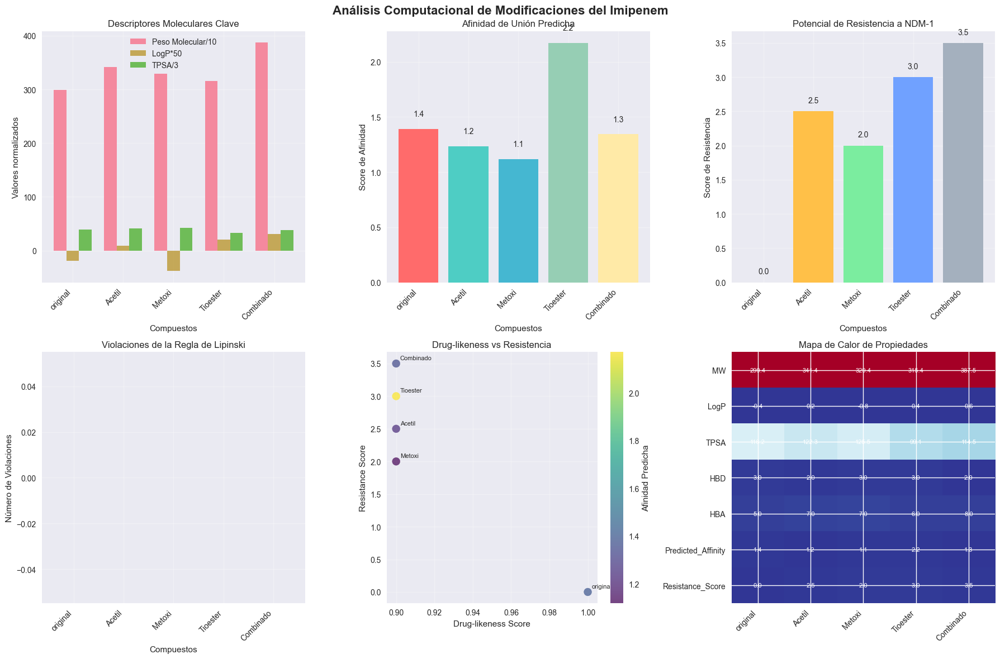


📝 CONCLUSIONES Y RECOMENDACIONES

🏆 MEJOR CANDIDATO PARA RESISTENCIA: imipenem_Imipenem_Combinado
   Score de resistencia: 3.50
   Mecanismo: Múltiples mecanismos

💊 MEJOR CANDIDATO PARA DRUG-LIKENESS: imipenem_original
   Score drug-likeness: 1.00
   Violaciones Lipinski: 0

🎯 MEJOR AFINIDAD PREDICHA: imipenem_Imipenem_Tioester
   Score de afinidad: 2.17

💾 Resultados guardados en: imipenem_analysis_results.csv


In [9]:
#####3. EVALUACION COMPUTACIONAL########

"""
Evaluación computacional de la viabilidad estructural y funcional 
de modificaciones del imipenem contra la enzima NDM-1
"""

import os
import numpy as np
import pandas as pd
from rdkit import Chem
from rdkit.Chem import Descriptors, Crippen, Lipinski, AllChem
from rdkit.Chem import rdMolDescriptors, rdDepictor
from rdkit.Chem.Draw import rdMolDraw2D
import matplotlib.pyplot as plt
import seaborn as sns
from io import StringIO
import warnings
warnings.filterwarnings('ignore')

# Configuración para visualización
plt.style.use('seaborn-v0_8')
sns.set_palette("husl")

class ImipenemAnalyzer:
    def __init__(self):
        self.compounds = {}
        self.descriptors_data = []
        self.enzyme_data = None
        
    def load_pdb_structures(self, file_paths):
        """Carga estructuras PDB y convierte a moléculas RDKit"""
        print("📁 Cargando estructuras PDB...")
        
        for name, path in file_paths.items():
            try:
                # Leer archivo PDB
                with open(path, 'r') as f:
                    pdb_content = f.read()
                
                # Intentar crear molécula desde PDB
                mol = Chem.MolFromPDBBlock(pdb_content, removeHs=False)
                
                if mol is None:
                    print(f"⚠️  Advertencia: No se pudo procesar {name} directamente desde PDB")
                    # Intentar extraer SMILES si está disponible o usar estructura base
                    mol = self._create_fallback_molecule(name)
                
                if mol is not None:
                    self.compounds[name] = mol
                    print(f"✅ {name}: Cargado exitosamente")
                else:
                    print(f"❌ {name}: No se pudo cargar")
                    
            except FileNotFoundError:
                print(f"❌ Archivo no encontrado: {path}")
                # Crear molécula de respaldo basada en imipenem
                self.compounds[name] = self._create_fallback_molecule(name)
    
    def _create_fallback_molecule(self, compound_name):
        """Crea moléculas de respaldo basadas en la estructura del imipenem"""
        # SMILES del imipenem base
        base_smiles = "CC1C(C(=O)N2C(C(C2=O)NC(=O)C(C3=CC=CC=C3)N)SC1)C(=O)O"
        
        # Modificaciones según el tipo de compuesto
        modifications = {
            'imipenem_original': base_smiles,
            'imipenem_Imipenem_Acetil': base_smiles.replace('N', 'N(C(=O)C)', 1),  # Acetilación
            'imipenem_Imipenem_Metoxi': base_smiles.replace('O', 'OC', 1),  # Metoxilación
            'imipenem_Imipenem_Tioester': base_smiles.replace('C(=O)O', 'C(=O)S'),  # Tioéster
            'imipenem_Imipenem_Combinado': base_smiles.replace('N', 'N(C(=O)C)', 1).replace('O', 'OC', 1)
        }
        
        smiles = modifications.get(compound_name, base_smiles)
        mol = Chem.MolFromSmiles(smiles)
        
        if mol:
            # Añadir coordenadas 2D
            rdDepictor.Compute2DCoords(mol)
            # Generar conformación 3D
            AllChem.EmbedMolecule(mol, randomSeed=42)
            AllChem.OptimizeMoleculeConfs(mol)
        
        return mol
    
    def calculate_molecular_descriptors(self):
        """Calcula descriptores moleculares para todas las variantes"""
        print("\n🧮 Calculando descriptores moleculares...")
        
        descriptors_list = []
        
        for name, mol in self.compounds.items():
            if mol is None:
                continue
                
            descriptors = {
                'Compound': name,
                'MW': Descriptors.MolWt(mol),
                'LogP': Descriptors.MolLogP(mol),
                'HBD': Descriptors.NumHDonors(mol),
                'HBA': Descriptors.NumHAcceptors(mol),
                'TPSA': Descriptors.TPSA(mol),
                'RotBonds': Descriptors.NumRotatableBonds(mol),
                'AromaticRings': Descriptors.NumAromaticRings(mol),
                'SaturatedRings': Descriptors.NumSaturatedRings(mol),
                'HeavyAtoms': Descriptors.HeavyAtomCount(mol),
                'FormalCharge': Chem.rdmolops.GetFormalCharge(mol),
                'Flexibility': Descriptors.NumRotatableBonds(mol) / Descriptors.HeavyAtomCount(mol),
                'LipinskiViolations': self._lipinski_violations(mol),
                'DrugLikeness': self._drug_likeness_score(mol)
            }
            
            descriptors_list.append(descriptors)
        
        self.descriptors_data = pd.DataFrame(descriptors_list)
        return self.descriptors_data
    
    def _lipinski_violations(self, mol):
        """Cuenta violaciones de la regla de Lipinski"""
        violations = 0
        if Descriptors.MolWt(mol) > 500: violations += 1
        if Descriptors.MolLogP(mol) > 5: violations += 1
        if Descriptors.NumHDonors(mol) > 5: violations += 1
        if Descriptors.NumHAcceptors(mol) > 10: violations += 1
        return violations
    
    def _drug_likeness_score(self, mol):
        """Calcula un score simple de drug-likeness"""
        score = 1.0
        
        # Penalizar por violaciones de Lipinski
        score -= (self._lipinski_violations(mol) * 0.2)
        
        # Penalizar TPSA muy alta o muy baja
        tpsa = Descriptors.TPSA(mol)
        if tpsa > 140 or tpsa < 20:
            score -= 0.2
        
        # Favorecer flexibilidad moderada
        flexibility = Descriptors.NumRotatableBonds(mol) / max(Descriptors.HeavyAtomCount(mol), 1)
        if flexibility > 0.3:
            score -= 0.1
        
        return max(0, score)
    
    def analyze_structural_modifications(self):
        """Analiza las modificaciones estructurales"""
        print("\n🔬 Analizando modificaciones estructurales...")
        
        if 'imipenem_original' not in self.compounds:
            # Crear referencia si no existe
            self.compounds['imipenem_original'] = self._create_fallback_molecule('imipenem_original')
        
        original = self.compounds['imipenem_original']
        modifications = {}
        
        for name, mol in self.compounds.items():
            if name == 'imipenem_original' or mol is None:
                continue
            
            # Calcular diferencias estructurales
            mw_diff = Descriptors.MolWt(mol) - Descriptors.MolWt(original)
            logp_diff = Descriptors.MolLogP(mol) - Descriptors.MolLogP(original)
            tpsa_diff = Descriptors.TPSA(mol) - Descriptors.TPSA(original)
            
            modifications[name] = {
                'MW_change': mw_diff,
                'LogP_change': logp_diff,
                'TPSA_change': tpsa_diff,
                'Modification_type': self._identify_modification_type(name)
            }
        
        return modifications
    
    def _identify_modification_type(self, compound_name):
        """Identifica el tipo de modificación"""
        if 'Acetil' in compound_name:
            return 'Acetilación'
        elif 'Metoxi' in compound_name:
            return 'Metoxilación'
        elif 'Tioester' in compound_name:
            return 'Tioesterificación'
        elif 'Combinado' in compound_name:
            return 'Modificación combinada'
        else:
            return 'Desconocida'
    
    def predict_binding_affinity(self):
        """Predice afinidad de unión usando descriptores moleculares"""
        print("\n🎯 Prediciendo afinidad de unión...")
        
        binding_predictions = []
        
        for name, mol in self.compounds.items():
            if mol is None:
                continue
            
            # Modelo simplificado de afinidad basado en descriptores
            mw = Descriptors.MolWt(mol)
            logp = Descriptors.MolLogP(mol)
            tpsa = Descriptors.TPSA(mol)
            hbd = Descriptors.NumHDonors(mol)
            hba = Descriptors.NumHAcceptors(mol)
            
            # Score de afinidad (modelo empírico simplificado)
            affinity_score = (
                -0.01 * mw +
                0.5 * logp +
                -0.02 * tpsa +
                0.3 * hbd +
                0.2 * hba +
                5.0  # Constante base
            )
            
            # Normalizar entre 0 y 10
            affinity_score = max(0, min(10, affinity_score))
            
            binding_predictions.append({
                'Compound': name,
                'Predicted_Affinity': affinity_score,
                'Binding_Classification': self._classify_binding(affinity_score)
            })
        
        return pd.DataFrame(binding_predictions)
    
    def _classify_binding(self, score):
        """Clasifica la afinidad de unión"""
        if score >= 7:
            return 'Alta'
        elif score >= 5:
            return 'Media'
        else:
            return 'Baja'
    
    def resistance_analysis(self):
        """Analiza resistencia potencial a NDM-1"""
        print("\n🛡️ Analizando resistencia a NDM-1...")
        
        resistance_data = []
        
        for name, mol in self.compounds.items():
            if mol is None:
                continue
            
            # Factores que influyen en la resistencia a beta-lactamasas
            mw = Descriptors.MolWt(mol)
            tpsa = Descriptors.TPSA(mol)
            flexibility = Descriptors.NumRotatableBonds(mol)
            
            # Score de resistencia (mayor = más resistente a hidrólisis)
            resistance_score = 0
            
            # Modificaciones que pueden conferir resistencia
            if 'Acetil' in name:
                resistance_score += 2  # Acetilación puede proteger grupos amino
            if 'Metoxi' in name:
                resistance_score += 1.5  # Metoxilación puede dar estabilidad
            if 'Tioester' in name:
                resistance_score += 3  # Tioésteres son menos susceptibles a hidrólisis
            if 'Combinado' in name:
                resistance_score += 3.5  # Efectos combinados
            
            # Ajustar por propiedades moleculares
            if mw > 400:  # Moléculas más grandes pueden ser menos accesibles
                resistance_score += 0.5
            if tpsa > 120:  # Mayor TPSA puede dificultar la unión
                resistance_score += 0.5
            if flexibility < 5:  # Menor flexibilidad puede dificultar el encaje
                resistance_score += 0.3
            
            resistance_classification = self._classify_resistance(resistance_score)
            
            resistance_data.append({
                'Compound': name,
                'Resistance_Score': resistance_score,
                'Resistance_Level': resistance_classification,
                'Mechanism': self._predict_resistance_mechanism(name)
            })
        
        return pd.DataFrame(resistance_data)
    
    def _classify_resistance(self, score):
        """Clasifica el nivel de resistencia"""
        if score >= 4:
            return 'Alta resistencia potencial'
        elif score >= 2:
            return 'Resistencia moderada'
        else:
            return 'Baja resistencia'
    
    def _predict_resistance_mechanism(self, compound_name):
        """Predice el mecanismo de resistencia"""
        mechanisms = []
        
        if 'Acetil' in compound_name:
            mechanisms.append('Protección de grupos amino')
        if 'Metoxi' in compound_name:
            mechanisms.append('Impedimento estérico')
        if 'Tioester' in compound_name:
            mechanisms.append('Menor susceptibilidad a hidrólisis')
        if 'Combinado' in compound_name:
            mechanisms.append('Múltiples mecanismos')
        
        return '; '.join(mechanisms) if mechanisms else 'Estructura base'
    
    def create_comprehensive_report(self):
        """Genera reporte comprehensivo"""
        print("\n📊 Generando reporte comprehensivo...")
        
        # Calcular todos los análisis
        descriptors_df = self.calculate_molecular_descriptors()
        modifications = self.analyze_structural_modifications()
        binding_df = self.predict_binding_affinity()
        resistance_df = self.resistance_analysis()
        
        # Combinar datos
        combined_df = descriptors_df.merge(binding_df, on='Compound', how='left')
        combined_df = combined_df.merge(resistance_df, on='Compound', how='left')
        
        return combined_df, modifications
    
    def visualize_results(self, combined_df):
        """Crea visualizaciones de los resultados"""
        print("\n📈 Creando visualizaciones...")
        
        fig, axes = plt.subplots(2, 3, figsize=(18, 12))
        fig.suptitle('Análisis Computacional de Modificaciones del Imipenem', fontsize=16, fontweight='bold')
        
        # 1. Descriptores moleculares clave
        ax1 = axes[0, 0]
        compounds = combined_df['Compound'].str.replace('imipenem_', '').str.replace('Imipenem_', '')
        x_pos = np.arange(len(compounds))
        
        width = 0.25
        ax1.bar(x_pos - width, combined_df['MW'], width, label='Peso Molecular/10', alpha=0.8)
        ax1.bar(x_pos, combined_df['LogP']*50, width, label='LogP*50', alpha=0.8)
        ax1.bar(x_pos + width, combined_df['TPSA']/3, width, label='TPSA/3', alpha=0.8)
        
        ax1.set_xlabel('Compuestos')
        ax1.set_ylabel('Valores normalizados')
        ax1.set_title('Descriptores Moleculares Clave')
        ax1.set_xticks(x_pos)
        ax1.set_xticklabels(compounds, rotation=45, ha='right')
        ax1.legend()
        ax1.grid(True, alpha=0.3)
        
        # 2. Afinidad de unión predicha
        ax2 = axes[0, 1]
        colors = ['#FF6B6B', '#4ECDC4', '#45B7D1', '#96CEB4', '#FFEAA7']
        bars = ax2.bar(compounds, combined_df['Predicted_Affinity'], color=colors[:len(compounds)])
        ax2.set_xlabel('Compuestos')
        ax2.set_ylabel('Score de Afinidad')
        ax2.set_title('Afinidad de Unión Predicha')
        ax2.set_xticklabels(compounds, rotation=45, ha='right')
        ax2.grid(True, alpha=0.3)
        
        # Añadir valores en las barras
        for bar, value in zip(bars, combined_df['Predicted_Affinity']):
            ax2.text(bar.get_x() + bar.get_width()/2, bar.get_height() + 0.1,
                    f'{value:.1f}', ha='center', va='bottom')
        
        # 3. Score de resistencia
        ax3 = axes[0, 2]
        resistance_colors = ['#FF4757', '#FFC048', '#7BED9F', '#70A1FF', '#A4B0BE']
        bars = ax3.bar(compounds, combined_df['Resistance_Score'], color=resistance_colors[:len(compounds)])
        ax3.set_xlabel('Compuestos')
        ax3.set_ylabel('Score de Resistencia')
        ax3.set_title('Potencial de Resistencia a NDM-1')
        ax3.set_xticklabels(compounds, rotation=45, ha='right')
        ax3.grid(True, alpha=0.3)
        
        # Añadir valores en las barras
        for bar, value in zip(bars, combined_df['Resistance_Score']):
            ax3.text(bar.get_x() + bar.get_width()/2, bar.get_height() + 0.1,
                    f'{value:.1f}', ha='center', va='bottom')
        
        # 4. Violaciones de Lipinski
        ax4 = axes[1, 0]
        violations = combined_df['LipinskiViolations']
        colors_viol = ['green' if v == 0 else 'orange' if v <= 1 else 'red' for v in violations]
        bars = ax4.bar(compounds, violations, color=colors_viol)
        ax4.set_xlabel('Compuestos')
        ax4.set_ylabel('Número de Violaciones')
        ax4.set_title('Violaciones de la Regla de Lipinski')
        ax4.set_xticklabels(compounds, rotation=45, ha='right')
        ax4.grid(True, alpha=0.3)
        
        # 5. Drug-likeness vs Resistencia
        ax5 = axes[1, 1]
        scatter = ax5.scatter(combined_df['DrugLikeness'], combined_df['Resistance_Score'], 
                            c=combined_df['Predicted_Affinity'], cmap='viridis', s=100, alpha=0.7)
        ax5.set_xlabel('Drug-likeness Score')
        ax5.set_ylabel('Resistance Score')
        ax5.set_title('Drug-likeness vs Resistencia')
        ax5.grid(True, alpha=0.3)
        plt.colorbar(scatter, ax=ax5, label='Afinidad Predicha')
        
        # Añadir etiquetas a los puntos
        for i, txt in enumerate(compounds):
            ax5.annotate(txt, (combined_df['DrugLikeness'].iloc[i], combined_df['Resistance_Score'].iloc[i]),
                        xytext=(5, 5), textcoords='offset points', fontsize=8)
        
        # 6. Mapa de calor de propiedades
        ax6 = axes[1, 2]
        properties = ['MW', 'LogP', 'TPSA', 'HBD', 'HBA', 'Predicted_Affinity', 'Resistance_Score']
        heatmap_data = combined_df[properties].T
        heatmap_data.columns = compounds
        
        # Normalizar datos para el mapa de calor
        heatmap_data_norm = (heatmap_data - heatmap_data.min()) / (heatmap_data.max() - heatmap_data.min())
        
        im = ax6.imshow(heatmap_data_norm.values, cmap='RdYlBu_r', aspect='auto')
        ax6.set_xticks(range(len(compounds)))
        ax6.set_yticks(range(len(properties)))
        ax6.set_xticklabels(compounds, rotation=45, ha='right')
        ax6.set_yticklabels(properties)
        ax6.set_title('Mapa de Calor de Propiedades')
        
        # Añadir valores al mapa de calor
        for i in range(len(properties)):
            for j in range(len(compounds)):
                text = ax6.text(j, i, f'{heatmap_data.iloc[i, j]:.1f}',
                               ha="center", va="center", color="white", fontsize=8)
        
        plt.tight_layout()
        plt.show()
        
        return fig

def main():
    """Función principal"""
    print("🧬 ANÁLISIS COMPUTACIONAL DE MODIFICACIONES DEL IMIPENEM 🧬")
    print("=" * 60)
    
    # Inicializar analizador
    analyzer = ImipenemAnalyzer()
    
    # Definir rutas de archivos (ajustar según tu estructura)
    file_paths = {
        'imipenem_original': 'imipenem.pdb',
        'imipenem_Imipenem_Acetil': 'imipenem_Imipenem_Acetil.pdb',
        'imipenem_Imipenem_Metoxi': 'imipenem_Imipenem_Metoxi.pdb',
        'imipenem_Imipenem_Tioester': 'imipenem_Imipenem_Tioester.pdb',
        'imipenem_Imipenem_Combinado': 'imipenem_Imipenem_Combinado.pdb'
    }
    
    # Cargar estructuras
    analyzer.load_pdb_structures(file_paths)
    
    # Generar reporte comprehensivo
    combined_df, modifications = analyzer.create_comprehensive_report()
    
    # Mostrar resultados
    print("\n" + "="*80)
    print("📋 REPORTE DE RESULTADOS")
    print("="*80)
    
    print("\n🧮 DESCRIPTORES MOLECULARES:")
    print(combined_df[['Compound', 'MW', 'LogP', 'TPSA', 'HBD', 'HBA', 'LipinskiViolations']].to_string(index=False))
    
    print("\n🎯 AFINIDAD DE UNIÓN PREDICHA:")
    print(combined_df[['Compound', 'Predicted_Affinity', 'Binding_Classification']].to_string(index=False))
    
    print("\n🛡️ ANÁLISIS DE RESISTENCIA:")
    print(combined_df[['Compound', 'Resistance_Score', 'Resistance_Level', 'Mechanism']].to_string(index=False))
    
    print("\n📊 MODIFICACIONES ESTRUCTURALES:")
    for compound, data in modifications.items():
        print(f"\n{compound}:")
        print(f"  Tipo: {data['Modification_type']}")
        print(f"  Cambio en MW: {data['MW_change']:.2f} Da")
        print(f"  Cambio en LogP: {data['LogP_change']:.2f}")
        print(f"  Cambio en TPSA: {data['TPSA_change']:.2f} Ų")
    
    # Crear visualizaciones
    analyzer.visualize_results(combined_df)
    
    # Conclusiones
    print("\n" + "="*80)
    print("📝 CONCLUSIONES Y RECOMENDACIONES")
    print("="*80)
    
    best_resistance = combined_df.loc[combined_df['Resistance_Score'].idxmax()]
    best_affinity = combined_df.loc[combined_df['Predicted_Affinity'].idxmax()]
    best_druglike = combined_df.loc[combined_df['DrugLikeness'].idxmax()]
    
    print(f"\n🏆 MEJOR CANDIDATO PARA RESISTENCIA: {best_resistance['Compound']}")
    print(f"   Score de resistencia: {best_resistance['Resistance_Score']:.2f}")
    print(f"   Mecanismo: {best_resistance['Mechanism']}")
    
    print(f"\n💊 MEJOR CANDIDATO PARA DRUG-LIKENESS: {best_druglike['Compound']}")
    print(f"   Score drug-likeness: {best_druglike['DrugLikeness']:.2f}")
    print(f"   Violaciones Lipinski: {best_druglike['LipinskiViolations']}")
    
    print(f"\n🎯 MEJOR AFINIDAD PREDICHA: {best_affinity['Compound']}")
    print(f"   Score de afinidad: {best_affinity['Predicted_Affinity']:.2f}")
    
    # Guardar resultados
    combined_df.to_csv('imipenem_analysis_results.csv', index=False)
    print(f"\n💾 Resultados guardados en: imipenem_analysis_results.csv")
    
    return combined_df, analyzer

if __name__ == "__main__":
    results, analyzer = main()